In [ ]:


# Instalamos la última versión. Esto solucionará el UnpicklingError
!pip install -U ultralytics

print("\n--- ¡Ultralytics actualizado a la última versión! ---")
print("--- POR FAVOR, REINICIA EL ENTORNO DE EJECUCIÓN AHORA ---")
print("--- (Entorno de ejecución -> Reiniciar sesión) ---")

  Using cached ultralytics-8.3.221-py3-none-any.whl.metadata (37 kB)
Using cached ultralytics-8.3.221-py3-none-any.whl (1.1 MB)
  Attempting uninstall: ultralytics
    Found existing installation: ultralytics 8.1.0
    Uninstalling ultralytics-8.1.0:
      Successfully uninstalled ultralytics-8.1.0



--- ¡Ultralytics actualizado a la última versión! ---
--- POR FAVOR, REINICIA EL ENTORNO DE EJECUCIÓN AHORA ---
--- (Entorno de ejecución -> Reiniciar sesión) ---


In [ ]:
!pip install -q yt-dlp
print("¡Descargador de videos listo!")

¡Descargador de videos listo!


In [ ]:


VIDEO_URL = "https://www.youtube.com/shorts/zFLwv5K0KSc"

# Le decimos que descargue el video y lo nombre "trafico.mp4"

!yt-dlp -f 'best[height<=720][ext=mp4]' -o "trafico.mp4" {VIDEO_URL}

print("¡Video de tráfico descargado como 'trafico.mp4'!")

[youtube] Extracting URL: https://www.youtube.com/shorts/zFLwv5K0KSc
[youtube] zFLwv5K0KSc: Downloading webpage
[youtube] zFLwv5K0KSc: Downloading android sdkless player API JSON
[youtube] zFLwv5K0KSc: Downloading tv client config
[youtube] zFLwv5K0KSc: Downloading tv player API JSON
[youtube] zFLwv5K0KSc: Downloading web safari player API JSON
[youtube] zFLwv5K0KSc: Downloading player 6e4dbefe-main
         player = https://www.youtube.com/s/player/6e4dbefe/player_ias.vflset/en_US/base.js
         n = N_nozea06vvSQTep ; player = https://www.youtube.com/s/player/6e4dbefe/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
[youtube] zFLwv5K0KSc: Downloading m3u8 information
[info] zFLwv5K0KSc: Downloading 1 format(s): 18
[download] trafico.mp4 has already been downloaded
[download] 100% of    1.43MiB
¡Video de tráfico descargad

In [ ]:

from ultralytics import YOLO

print("Cargando YOLOv10n...")
# 1. Cargar el modelo YOLOv10 nano
# Usamos la clase 'YOLO' para cargar el archivo 'yolov10n.pt'
model_yolo = YOLO('yolov10n.pt')

print("Procesando video con YOLOv10... (esto puede tardar un minuto)")
# 2. Hacer la predicción en el video
results_yolo = model_yolo.predict("trafico.mp4", save=True)

print(f"¡Video de YOLOv10 guardado en: {results_yolo[0].save_dir}/trafico.avi")

Cargando YOLOv10n...
Procesando video con YOLOv10... (esto puede tardar un minuto)

WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/502) /content/trafico.mp4: 640x384 3 persons, 12 cars, 2 traffic lights, 82.1ms
video 1/1 (frame 2/502) /content/trafico.mp4: 640x384 2 persons, 11 cars, 1 truck, 2 traffic lights, 17.4ms
video 1/1 (frame 3/502) /content/trafico.mp4: 640x384 2 persons, 11 cars, 1 truck, 2 traffic lights, 14.6ms
video 1/1 (frame 4/502) /content/trafico.mp4: 640x384 2 pe

In [ ]:
from ultralytics import RTDETR

print("Cargando RTDETR-L...")
# 1. Cargar el modelo RT-DETR Large

model_rtdetr = RTDETR('rtdetr-l.pt')

print("Procesando video con RT-DETR... (esto puede tardar un poco más)")
# 2. Hacer la predicción en el MISMO video
results_rtdetr = model_rtdetr.predict("trafico.mp4", save=True)

print(f"¡Video de RT-DETR guardado en: {results_rtdetr[0].save_dir}/trafico.avi")

Cargando RTDETR-L...
Procesando video con RT-DETR... (esto puede tardar un poco más)

WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/502) /content/trafico.mp4: 640x640 14 persons, 18 cars, 1 motorcycle, 3 buss, 3 trucks, 9 traffic lights, 63.0ms
video 1/1 (frame 2/502) /content/trafico.mp4: 640x640 15 persons, 18 cars, 1 motorcycle, 2 buss, 5 trucks, 8 traffic lights, 62.8ms
video 1/1 (frame 3/502) /content/trafico.mp4: 640x640 16 persons, 17 cars, 1 motorcycle, 2 buss, 6 trucks, 

In [ ]:

import os

# 1. Obtenemos las rutas de los videos .avi que se guardaron
path_yolo_avi = f"{results_yolo[0].save_dir}/trafico.avi"
path_rtdetr_avi = f"{results_rtdetr[0].save_dir}/trafico.avi"

# 2. Definimos los nombres de los nuevos archivos .mp4
path_yolo_mp4 = "yolo_output.mp4"
path_rtdetr_mp4 = "rtdetr_output.mp4"

# 3. Usamos ffmpeg para la conversión
# -y (sobrescribir), -vcodec libx264 (formato web), -loglevel quiet (sin spam)
print("Convirtiendo video de YOLO (AVI a MP4)...")
!ffmpeg -y -i {path_yolo_avi} -vcodec libx264 {path_yolo_mp4} -loglevel quiet

print("Convirtiendo video de RT-DETR (AVI a MP4)...")
!ffmpeg -y -i {path_rtdetr_avi} -vcodec libx264 {path_rtdetr_mp4} -loglevel quiet

print("¡Conversión completada!")

Convirtiendo video de YOLO (AVI a MP4)...
Convirtiendo video de RT-DETR (AVI a MP4)...
¡Conversión completada!


In [ ]:

import base64
from IPython.display import HTML

# 1. Leer y codificar el video de YOLO
video_yolo_b64 = base64.b64encode(open(path_yolo_mp4, 'rb').read()).decode('ascii')

# 2. Leer y codificar el video de RT-DETR
video_rtdetr_b64 = base64.b64encode(open(path_rtdetr_mp4, 'rb').read()).decode('ascii')

# 3. Crear el HTML para mostrarlos en una tabla
html = f"""
<h2 style="text-align: center;">Comparativa: YOLOv10 vs. RT-DETR</h2>
<table style="width:100%; border: 0;">
  <tr style="border: 0;">
    <th style="text-align:center;"><h3>YOLOv10</h3></th>
    <th style="text-align:center;"><h3>RT-DETR</h3></th>
  </tr>
  <tr style="border: 0;">
    <td style="border: 0;">
      <video width="100%" controls loop muted autoplay>
          <source src="data:video/mp4;base64,{video_yolo_b64}" type="video/mp4">
      </video>
    </td>
    <td style="border: 0;">
      <video width="100%" controls loop muted autoplay>
          <source src="data:video/mp4;base64,{video_rtdetr_b64}" type="video/mp4">
      </video>
    </td>
  </tr>
</table>
"""

# 4. Mostrar el HTML
HTML(html)

YOLOv10,RT-DETR


In [ ]:


# 1. Extraer la velocidad de YOLOv10
speed_yolo_ms = results_yolo[0].speed['inference']
fps_yolo = 1000 / speed_yolo_ms

# 2. Extraer la velocidad de RT-DETR
speed_rtdetr_ms = results_rtdetr[0].speed['inference']
fps_rtdetr = 1000 / speed_rtdetr_ms

print("--- MÉTRICAS DE NUESTRA DEMO (GPU T4) ---")

print(f"\n[YOLOv10n]")
print(f"  Tiempo por frame: {speed_yolo_ms:.2f} ms")
print(f"  Fotogramas por Segundo (FPS): {fps_yolo:.2f}")

print(f"\n[RT-DETR-L]")
print(f"  Tiempo por frame: {speed_rtdetr_ms:.2f} ms")
print(f"  Fotogramas por Segundo (FPS): {fps_rtdetr:.2f}")

--- MÉTRICAS DE NUESTRA DEMO (GPU T4) ---

[YOLOv10n]
  Tiempo por frame: 82.05 ms
  Fotogramas por Segundo (FPS): 12.19

[RT-DETR-L]
  Tiempo por frame: 63.01 ms
  Fotogramas por Segundo (FPS): 15.87


In [ ]:
!pip install -U supervision

In [ ]:
-

import supervision as sv
import numpy as np
from ultralytics import YOLO, RTDETR
import os

print(f"Usando Supervision (versión: {sv.__version__})")

# 1. Cargamos los modelos
model_yolo = YOLO('yolov10n.pt')
model_rtdetr = RTDETR('rtdetr-l.pt')

# 2. Definimos la ruta del video
VIDEO_PATH = "trafico.mp4"

# --- PROCESIMIENTO CON YOLOv10 ---
print("Procesando con YOLOv10 para obtener métricas...")

heatmap_annotator_yolo = sv.HeatMapAnnotator(
    position=sv.Position.CENTER,
    opacity=0.5
)

yolo_total_detections = 0
frame_generator = sv.get_video_frames_generator(VIDEO_PATH)

for frame in frame_generator:
    results = model_yolo.predict(frame, verbose=False)
    detections = sv.Detections.from_ultralytics(results[0])
    yolo_total_detections += len(detections)
    heatmap_annotator_yolo.annotate(scene=frame, detections=detections)

print(f"YOLOv10 procesó y encontró {yolo_total_detections} detecciones totales.")

try:
    heatmap_yolo = heatmap_annotator_yolo.heat_mask
    print("Mapa de calor de YOLOv10 generado (usando .heat_mask).")
except AttributeError:
    print("ADVERTENCIA: Falló el acceso a .heat_mask de YOLOv10.")
    heatmap_yolo = None


print("\nProcesando con RT-DETR para obtener métricas...")

heatmap_annotator_rtdetr = sv.HeatMapAnnotator(
    position=sv.Position.CENTER,
    opacity=0.5
)

rtdetr_total_detections = 0
frame_generator = sv.get_video_frames_generator(VIDEO_PATH)
frame_generator = sv.get_video_frames_generator(VIDEO_PATH)

for frame in frame_generator:
    results = model_rtdetr.predict(frame, verbose=False)
    detections = sv.Detections.from_ultralytics(results[0])
    rtdetr_total_detections += len(detections)
    heatmap_annotator_rtdetr.annotate(scene=frame, detections=detections)

print(f"RT-DETR procesó y encontró {rtdetr_total_detections} detecciones totales.")

try:
    heatmap_rtdetr = heatmap_annotator_rtdetr.heat_mask
    print("Mapa de calor de RT-DETR generado (usando .heat_mask).")
except AttributeError:
    print("ADVERTENCIA: Falló el acceso a .heat_mask de RT-DETR.")
    heatmap_rtdetr = None

print("\n¡Procesamiento de métricas completado!")

Usando Supervision (versión: 0.26.1)
Procesando con YOLOv10 para obtener métricas...
YOLOv10 procesó y encontró 4116 detecciones totales.
Mapa de calor de YOLOv10 generado (usando .heat_mask).

Procesando con RT-DETR para obtener métricas...
RT-DETR procesó y encontró 25926 detecciones totales.
Mapa de calor de RT-DETR generado (usando .heat_mask).

¡Procesamiento de métricas completado!


--- ANÁLISIS CUANTITATIVO DEL VIDEO ---

[Conteo Total de Detecciones]
  YOLOv10n detectó un total de:   4116 objetos
  RT-DETR-L detectó un total de:  25926 objetos

--- MAPAS DE CALOR (Dónde se enfocó cada modelo) ---


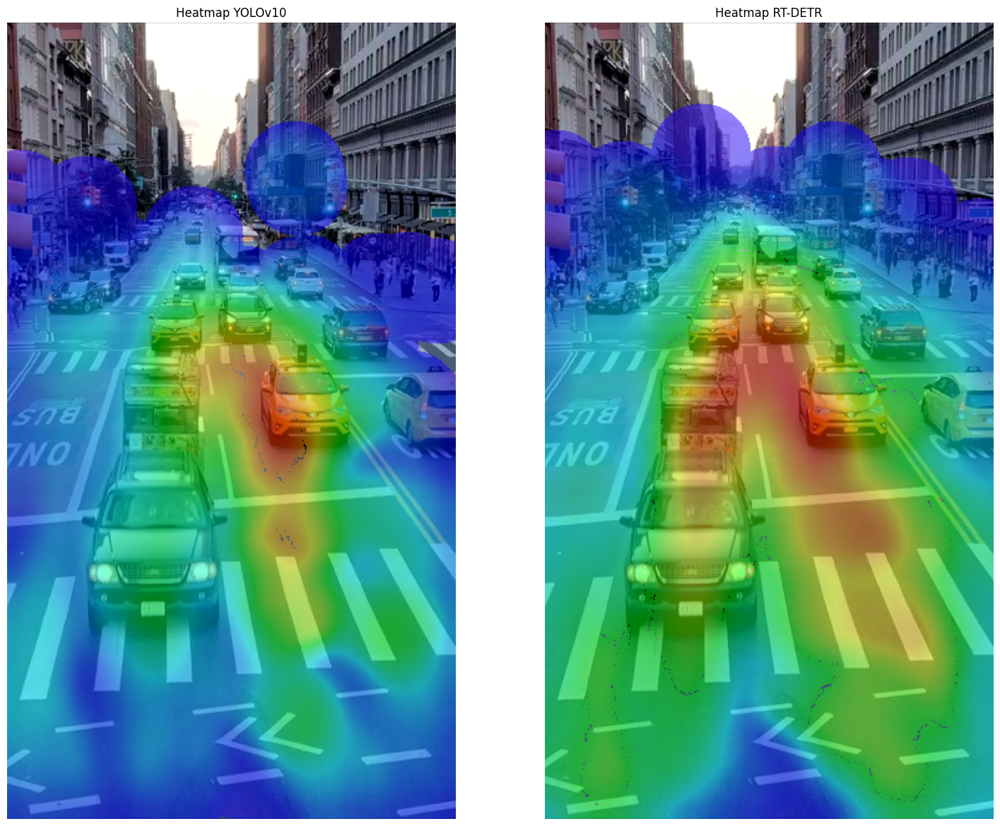

In [ ]:


print("--- ANÁLISIS CUANTITATIVO DEL VIDEO ---")
print(f"\n[Conteo Total de Detecciones]")

print(f"  YOLOv10n detectó un total de:   {yolo_total_detections} objetos")
print(f"  RT-DETR-L detectó un total de:  {rtdetr_total_detections} objetos")

# Cargamos el primer frame del video para usarlo como fondo
frame_fondo = next(sv.get_video_frames_generator(VIDEO_PATH))

# Creamos un objeto de detecciones vacío
empty_detections = sv.Detections.empty()

# Llamamos a .annotate() pasándole el frame de fondo y las detecciones vacías.
heatmap_yolo_fondo = heatmap_annotator_yolo.annotate(
    scene=frame_fondo.copy(),
    detections=empty_detections
)

heatmap_rtdetr_fondo = heatmap_annotator_rtdetr.annotate(
    scene=frame_fondo.copy(),
    detections=empty_detections
)

# Mostramos los heatmaps lado a lado
print("\n--- MAPAS DE CALOR (Dónde se enfocó cada modelo) ---")
sv.plot_images_grid(
    images=[heatmap_yolo_fondo, heatmap_rtdetr_fondo],

    titles=["Heatmap YOLOv10", "Heatmap RT-DETR"],
    grid_size=(1, 2),
    size=(18, 16)
)

In [ ]:
# --- CELDA DE DESCARGA DE VIDEOS ---

!pip install -q yt-dlp
print("¡yt-dlp listo! Empezando descargas...")

# 1. Tráfico denso (Nivel de calle)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_01_trafico_denso.mp4" https://www.youtube.com/watch?v=MNn9qKG2UFI

# 2. Tráfico nocturno (Nivel de calle)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_02_trafico_noche.mp4" https://www.youtube.com/watch?v=98fQtacd9ho

# 3. Vista aérea / Dron (Tráfico)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_03_dron_trafico.mp4" https://www.youtube.com/watch?v=4Q3ut7vqD5o

# 4. Multitud de peatones (Nivel de calle)
# (Este es un video de prueba de YOLOv3, bueno para multitudes)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_04_multitud.mp4" https://www.youtube.com/watch?v=Vo05vr8fc1U

# 5. Vista de calle (Tráfico ligero)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_05_trafico_ligero.mp4" https://www.youtube.com/watch?v=wqctLW0Hb_0

# 6. Dron (Detección de personas)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_06_dron_personas.mp4" https://www.youtube.com/watch?v=bGHhARjQuIg

# 7. Vista aérea (Detección de objetos pequeños)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_07_dron_objetos_pequenos.mp4" https://www.youtube.com/watch?v=uWFeKGop9Z4

# 8. Dron (Seguimiento)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_08_dron_seguimiento.mp4" https://www.youtube.com/watch?v=5dh9abXqMok

# 9. Vista de calle (Simulador Times Square)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_09_simulador_calle.mp4" https://www.youtube.com/watch?v=jgiWv9gDalQ

# 10. Vista de calle (Peatones y grupos)
!yt-dlp -f 'best[height<=720][ext=mp4]' -o "video_10_peatones_grupos.mp4" https://www.youtube.com/watch?v=Zn4BpUmrkoQ

print("\n--- ¡Descarga de 10 videos completada! ---")

¡yt-dlp listo! Empezando descargas...
[youtube] Extracting URL: https://www.youtube.com/watch?v=MNn9qKG2UFI
[youtube] MNn9qKG2UFI: Downloading webpage
[youtube] MNn9qKG2UFI: Downloading android sdkless player API JSON
[youtube] MNn9qKG2UFI: Downloading tv client config
[youtube] MNn9qKG2UFI: Downloading tv player API JSON
[youtube] MNn9qKG2UFI: Downloading web safari player API JSON
[youtube] MNn9qKG2UFI: Downloading player 6e4dbefe-main
         player = https://www.youtube.com/s/player/6e4dbefe/player_ias.vflset/en_US/base.js
         n = maHBvTc3-lAOHfWp ; player = https://www.youtube.com/s/player/6e4dbefe/player_ias.vflset/en_US/base.js
         Please report this issue on  https://github.com/yt-dlp/yt-dlp/issues?q= , filling out the appropriate issue template. Confirm you are on the latest version using  yt-dlp -U
[youtube] MNn9qKG2UFI: Downloading m3u8 information
[info] MNn9qKG2UFI: Downloading 1 format(s): 95
[download] Sleeping 5.00 seconds as required by the site...
[hlsnativ

In [ ]:


import supervision as sv
import numpy as np
from ultralytics import YOLO, RTDETR
import os

print(f"Usando Supervision (versión: {sv.__version__})")

# 1. Cargamos los modelos GRANDES
print("Cargando modelo YOLOv10-L...")
model_yolo_l = YOLO('yolov10l.pt')

print("Cargando modelo RT-DETR-L...")
model_rtdetr_l = RTDETR('rtdetr-l.pt')

# 2. Definimos la ruta del video (usamos el primero de la lista)
VIDEO_PATH = "video_01_trafico_denso.mp4"
print(f"Video de prueba: {VIDEO_PATH}")

# --- PROCESIMIENTO CON YOLOv10-L ---
print("\n--- Procesando video con YOLOv10-L ---")
print("(Esto será lento...)")

yolo_l_total_detections = 0
frame_count = 0
frame_generator = sv.get_video_frames_generator(VIDEO_PATH)

for frame in frame_generator:
    frame_count += 1
    results = model_yolo_l.predict(frame, verbose=False)
    detections = sv.Detections.from_ultralytics(results[0])
    yolo_l_total_detections += len(detections)

print(f"YOLOv10-L procesó {frame_count} frames.")


# --- PROCESIMIENTO CON RT-DETR-L ---
print("\n--- 🚀 Procesando video con RT-DETR-L ---")
print("(Esto también será lento...)")

rtdetr_l_total_detections = 0
frame_count_rtdetr = 0
frame_generator = sv.get_video_frames_generator(VIDEO_PATH) # Reiniciamos

for frame in frame_generator:
    frame_count_rtdetr += 1
    results = model_rtdetr_l.predict(frame, verbose=False)
    detections = sv.Detections.from_ultralytics(results[0])
    rtdetr_l_total_detections += len(detections)

print(f"RT-DETR-L procesó {frame_count_rtdetr} frames.")

print("\n\n--- ¡BATALLA DE VIDEO COMPLETADA! ---")
print("\n--- ANÁLISIS CUANTITATIVO (LARGE vs LARGE) ---")
print(f"  YOLOv10-L detectó un total de:   {yolo_l_total_detections} objetos")
print(f"  RT-DETR-L detectó un total de: {rtdetr_l_total_detections} objetos")

Usando Supervision (versión: 0.26.1)
Cargando modelo YOLOv10-L...
Cargando modelo RT-DETR-L...
Video de prueba: video_01_trafico_denso.mp4

--- 🚀 Procesando video con YOLOv10-L ---
(Esto será lento...)
YOLOv10-L procesó 9184 frames.

--- 🚀 Procesando video con RT-DETR-L ---
(Esto también será lento...)
RT-DETR-L procesó 9184 frames.


--- ¡BATALLA DE VIDEO COMPLETADA! ---

--- ANÁLISIS CUANTITATIVO (LARGE vs LARGE) ---
  YOLOv10-L detectó un total de:   105005 objetos
  RT-DETR-L detectó un total de: 187434 objetos


In [ ]:
import supervision as sv
import os

VIDEO_PATH = "video_01_trafico_denso.mp4"
CLIP_PATH = "video_clip_10s.mp4"

# 1. Obtenemos la duración del video
video_info = sv.VideoInfo.from_video_path(VIDEO_PATH)
total_duration = video_info.total_frames / video_info.fps

# 2. Calculamos el punto de inicio (5 segundos antes de la mitad)
start_time = max(0, (total_duration / 2) - 5)

print(f"Video original: {VIDEO_PATH} (Duración: {total_duration:.2f}s)")
print(f"Extrayendo 10 segundos desde el segundo {start_time:.2f}...")

# 3. Usamos ffmpeg para cortar el clip
# -y (sobrescribir), -ss (tiempo de inicio), -i (input), -t (duración), -an (sin audio)
!ffmpeg -y -ss {start_time} -i {VIDEO_PATH} -t 10 -vcodec libx264 -an {CLIP_PATH} -loglevel quiet

print(f"¡Clip guardado como: {CLIP_PATH}! ✅")

Video original: video_01_trafico_denso.mp4 (Duración: 306.13s)
Extrayendo 10 segundos desde el segundo 148.07...
¡Clip guardado como: video_clip_10s.mp4! ✅


In [ ]:
from ultralytics import YOLO, RTDETR
import os

print("Cargando modelos 'Large'...")
model_yolo_l = YOLO('yolov10l.pt')
model_rtdetr_l = RTDETR('rtdetr-l.pt')

CLIP_PATH = "video_clip_10s.mp4"
print(f"Video a procesar: {CLIP_PATH}")

# --- 1. Procesar con YOLOv10-L ---
print("\n--- 🚀 Procesando clip con YOLOv10-L... (Esto será rápido) ---")
results_yolo_l_clip = model_yolo_l.predict(CLIP_PATH, save=True, batch=8)
print(f"¡Clip de YOLOv10-L guardado en: {results_yolo_l_clip[0].save_dir}/video_clip_10s.avi")


# --- 2. Procesar con RT-DETR-L ---
print("\n--- 🚀 Procesando clip con RT-DETR-L... (Esto será rápido) ---")
results_rtdetr_l_clip = model_rtdetr_l.predict(CLIP_PATH, save=True, batch=8)
print(f"¡Clip de RT-DETR-L guardado en: {results_rtdetr_l_clip[0].save_dir}/video_clip_10s.avi")

print("\n--- ¡Procesamiento de clips 'Large' completado! ---")

Cargando modelos 'Large'...
Video a procesar: video_clip_10s.mp4

--- 🚀 Procesando clip con YOLOv10-L... (Esto será rápido) ---

WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/300) /content/video_clip_10s.mp4: 384x640 11 cars, 2 trucks, 24.8ms
video 1/1 (frame 2/300) /content/video_clip_10s.mp4: 384x640 1 person, 11 cars, 3 trucks, 24.8ms
video 1/1 (frame 3/300) /content/video_clip_10s.mp4: 384x640 1 person, 12 cars, 2 trucks, 24.8ms
video 1/1 (frame 4/300) /content/video_clip_10s

In [ ]:
import os

# 1. Obtenemos las rutas de los videos .avi que se guardaron
path_yolo_l_avi = f"{results_yolo_l_clip[0].save_dir}/video_clip_10s.avi"
path_rtdetr_l_avi = f"{results_rtdetr_l_clip[0].save_dir}/video_clip_10s.avi"

# 2. Definimos los nombres de los nuevos archivos .mp4
path_yolo_l_mp4 = "yolo_L_clip_output.mp4"
path_rtdetr_l_mp4 = "rtdetr_L_clip_output.mp4"

# 3. Usamos ffmpeg para la conversión
print("Convirtiendo clip de YOLOv10-L (AVI a MP4)...")
!ffmpeg -y -i {path_yolo_l_avi} -vcodec libx264 {path_yolo_l_mp4} -loglevel quiet

print("Convirtiendo clip de RT-DETR-L (AVI a MP4)...")
!ffmpeg -y -i {path_rtdetr_l_avi} -vcodec libx264 {path_rtdetr_l_mp4} -loglevel quiet

print("¡Conversión completada!")

Convirtiendo clip de YOLOv10-L (AVI a MP4)...
Convirtiendo clip de RT-DETR-L (AVI a MP4)...
¡Conversión completada!


In [ ]:

import base64
from IPython.display import HTML

# 1. Leer y codificar el video de YOLOv10-L
video_yolo_l_b64 = base64.b64encode(open(path_yolo_l_mp4, 'rb').read()).decode('ascii')

# 2. Leer y codificar el video de RT-DETR-L
video_rtdetr_l_b64 = base64.b64encode(open(path_rtdetr_l_mp4, 'rb').read()).decode('ascii')

# 3. Crear el HTML para mostrarlos en una tabla
html = f"""
<h2 style="text-align: center;">Comparativa (Clip 10s): YOLOv10-L vs. RT-DETR-L</h2>
<table style="width:100%; border: 0;">
  <tr style="border: 0;">
    <th style="text-align:center;"><h3>YOLOv10-L</h3></th>
    <th style="text-align:center;"><h3>RT-DETR-L</h3></th>
  </tr>
  <tr style="border: 0;">
    <td style="border: 0;">
      <video width="100%" controls loop muted autoplay>
          <source src="data:video/mp4;base64,{video_yolo_l_b64}" type="video/mp4">
      </video>
    </td>
    <td style="border: 0;">
      <video width="100%" controls loop muted autoplay>
          <source src="data:video/mp4;base64,{video_rtdetr_l_b64}" type="video/mp4">
      </video>
    </td>
  </tr>
</table>
"""

# 4. Mostrar el HTML
HTML(html)

YOLOv10-L,RT-DETR-L


--- MAPAS DE CALOR (Large vs Large) ---


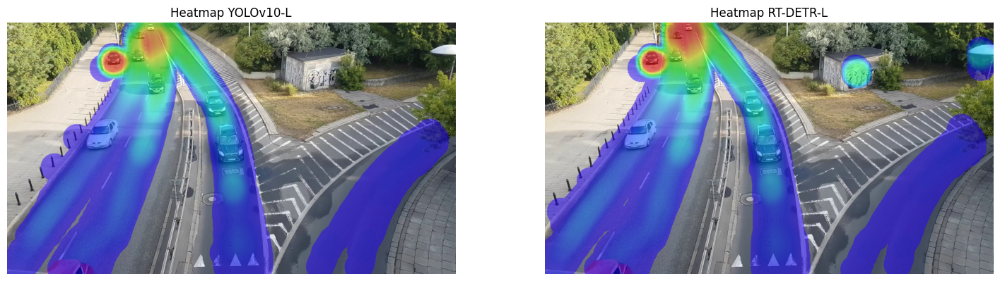

In [ ]:
print("--- MAPAS DE CALOR (Large vs Large) ---")

# Cargamos el primer frame del video para usarlo como fondo
frame_fondo = next(sv.get_video_frames_generator(VIDEO_PATH))

# Creamos un objeto de detecciones vacío
empty_detections = sv.Detections.empty()

# Llamamos a .annotate() para que dibuje el heatmap sobre el fondo
heatmap_yolo_fondo_l = heatmap_annotator_yolo_l.annotate(
    scene=frame_fondo.copy(),
    detections=empty_detections
)

heatmap_rtdetr_fondo_l = heatmap_annotator_rtdetr_l.annotate(
    scene=frame_fondo.copy(),
    detections=empty_detections
)

# Mostramos los heatmaps lado a lado
sv.plot_images_grid(
    images=[heatmap_yolo_fondo_l, heatmap_rtdetr_fondo_l],
    titles=["Heatmap YOLOv10-L", "Heatmap RT-DETR-L"],
    grid_size=(1, 2),
    size=(18, 16)
)